In [2]:
import wandb
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from tqdm.notebook import tqdm
import plotly.graph_objects as go
from plotly.offline import init_notebook_mode, iplot
import pandas as pd

%load_ext autoreload
%autoreload 2

init_notebook_mode(connected=True)

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [3]:
api = wandb.Api()

STEP_NUMBER = 34001

In [11]:
def display_imgs(p1_run, p2_run, buff, step, reduce_step = True, buffer=None):
    """
    Display image samples from a desired step
    p1_run: part1 run api access
    p2_run: part2 run api access, can be null
    buff: buffer from the first part (plot buffer, not iter buffer meaning last output index from part1)
    step: desired output step
    reduce_step: whether to reduce step when using part2 api
    buffer: buffer to save downloaded file paths
    """

    fig, axs = plt.subplots(2, 4, figsize=(32, 32))
    fig.tight_layout()
    i = 0

    constant_step = step

    collected_images = []

    if buffer is not None and step in buffer.keys():
        collected_images = buffer[step]

    run = p1_run
    if buff is not None:
        if step > buff:
            assert p2_run is not None, "Step is higher then buff but no p2 url found"
            run = p2_run
            if reduce_step:
                step -= buff

    for file in tqdm(run.files()):
        if len(collected_images) == 8:
            break

        if file.name.rfind(f"examples_{str(step)}_") >= 0:
            img_path = file.download(replace=True).name
            
            collected_images.append(img_path)
    
    if buffer is not None:
        buffer[constant_step] = collected_images

    for i in range(0, 8):
        img = mpimg.imread(collected_images[i])

        axs[i // 4, i % 4].imshow(img)

    plt.show()

In [9]:
def compare_from_buffer(buff1, buff2, step):
    """
    Compare generated outputs from 2 different runs
    buff1: buffer of first model
    buff2: buffer of second model
    step: desired visualization step
    """
    fig, axs = plt.subplots(8, 2, figsize=(32, 32))
    fig.tight_layout()

    for i, v in enumerate(buff1[step]):
        axs[i, 0].imshow(mpimg.imread(v))

    for i, v in enumerate(buff2[step]):
        axs[i, 1].imshow(mpimg.imread(v))

    plt.show()

# 1000 Diff

In [ ]:
d1000_p1_run = api.run("mlmioct22/OCT_DM_TRAIN/1p9qyfrk")
d1000_p2_run = api.run("mlmioct22/OCT_DM_TRAIN/1z5d91cf")

D1000_PART2_BUFF = 13900
D1000_PART2_BUFF_PLT = 13800

D1000_BUFFER = {}

  0%|          | 0/15475 [00:00<?, ?it/s]

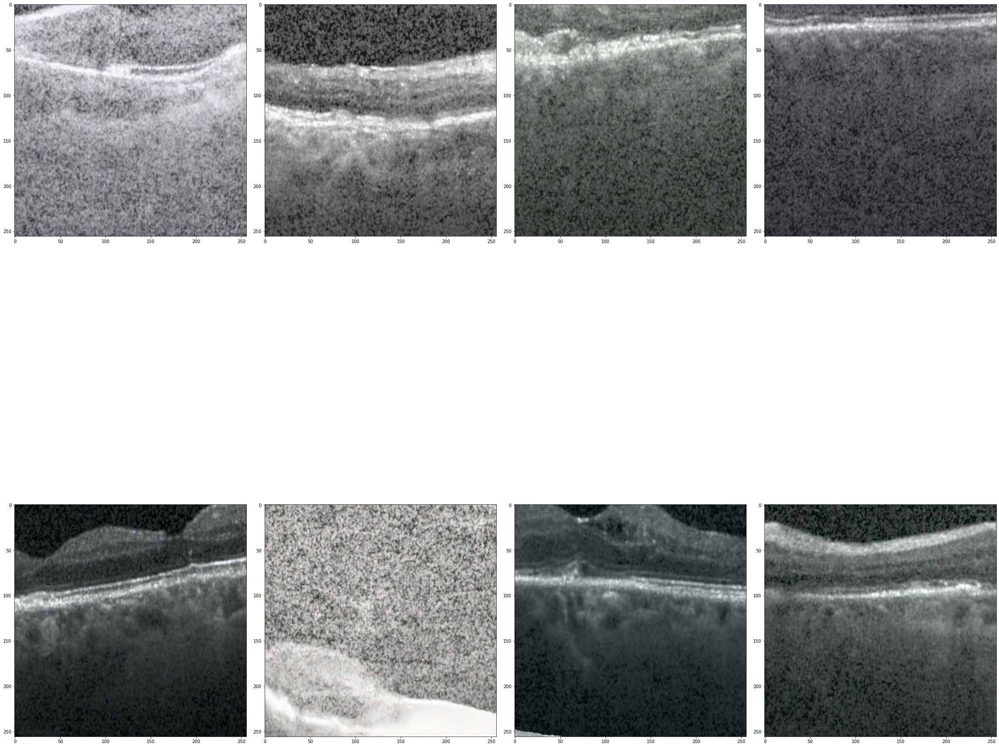

In [12]:
display_imgs(d1000_p1_run, d1000_p2_run, D1000_PART2_BUFF_PLT, STEP_NUMBER, buffer=D1000_BUFFER)

# Resize & Random

In [ ]:
resize_run = api.run("mlmioct22/OCT_DM_TRAIN/3w0a6hm1")

RESIZE_BUFFER = {}

  0%|          | 0/5891 [00:00<?, ?it/s]

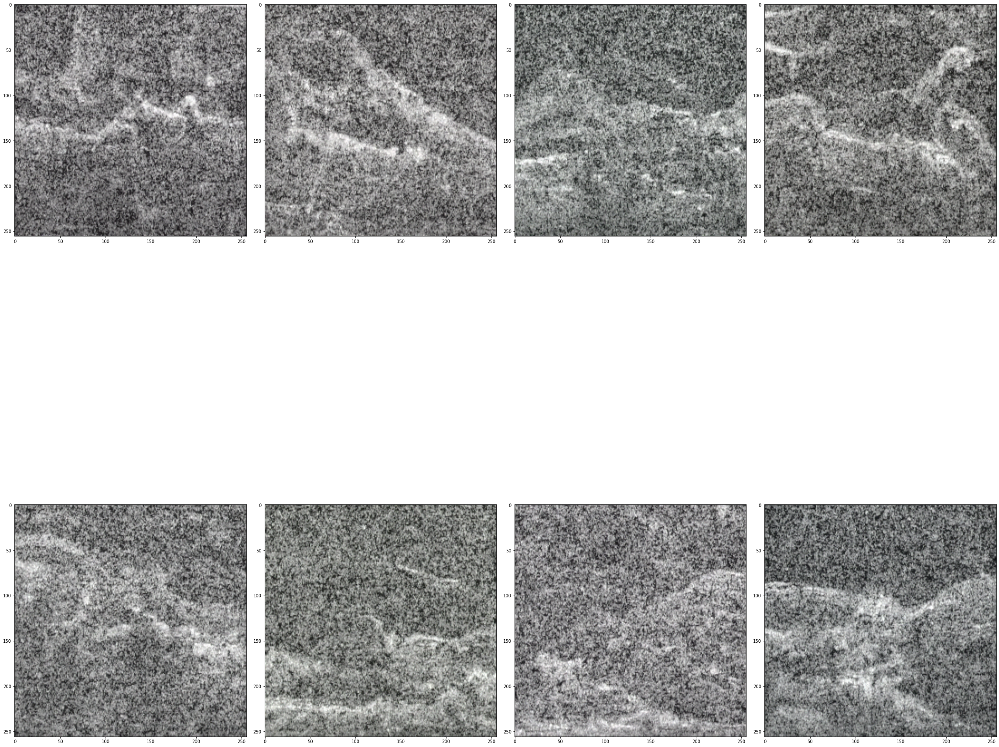

In [13]:
display_imgs(resize_run, None, None, STEP_NUMBER, buffer=RESIZE_BUFFER)

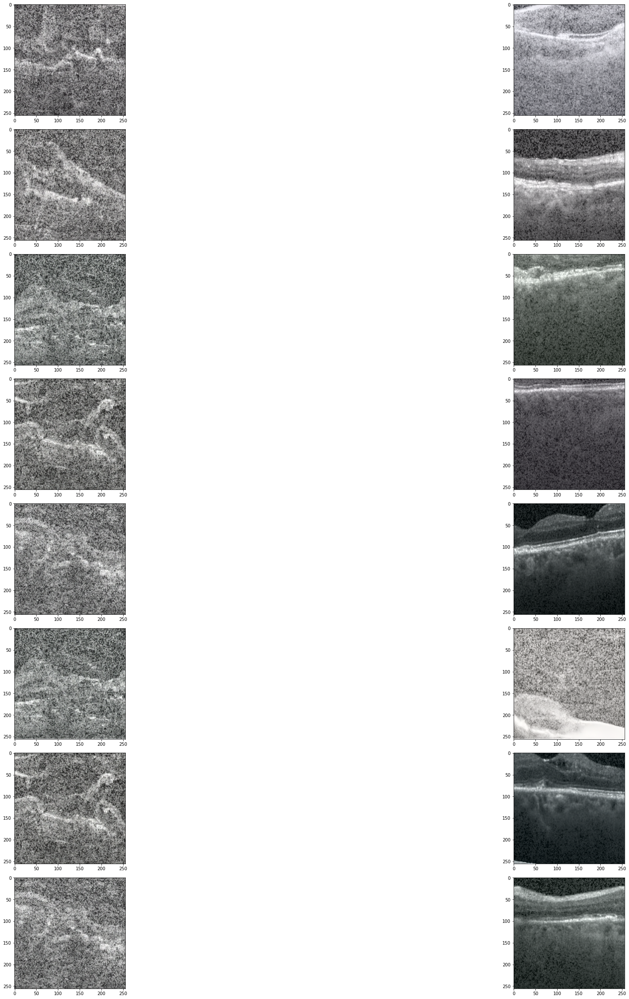

In [10]:
compare_from_buffer(RESIZE_BUFFER, D1000_BUFFER, STEP_NUMBER)

# Plots

In [14]:
METRICS_TO_LOOK_FOR = ["loss", "valid_loss", "mse", "valid_mse", "FID", "InceptionScore", "sFID"]

resize_df = resize_run.history()

d1000_df = d1000_p2_run.history()
d1000_df["step"] += (D1000_PART2_BUFF - d1000_df["step"].min() + 1)
d1000_df = pd.concat([d1000_df, d1000_p1_run.history()], ignore_index=True)

## Loss Curves

In [15]:
for col in METRICS_TO_LOOK_FOR:
    fig = go.Figure()

    fig.update_layout(
        title=f"{col} D1000 vs Resize",
        xaxis_title="Step",
        yaxis_title=col,
    )

    fig.add_trace(go.Scatter(x=resize_df["step"],   y=resize_df[col], mode="lines", name="Resize"))
    fig.add_trace(go.Scatter(x=d1000_df["step"],    y=d1000_df[col], mode="lines", name="D1000"))

    fig.show()

# D1000 vs D250

In [ ]:
d250_p1_run = api.run("mlmioct22/OCT_DM_TRAIN/2nnh48yo")
d250_p2_run = api.run("mlmioct22/OCT_DM_TRAIN/h252gnov")

D250_P1_BUFF = 21491
D250_P1_BUFF_PLT = 21490

D250_BUFFER = {}

  0%|          | 0/12775 [00:00<?, ?it/s]

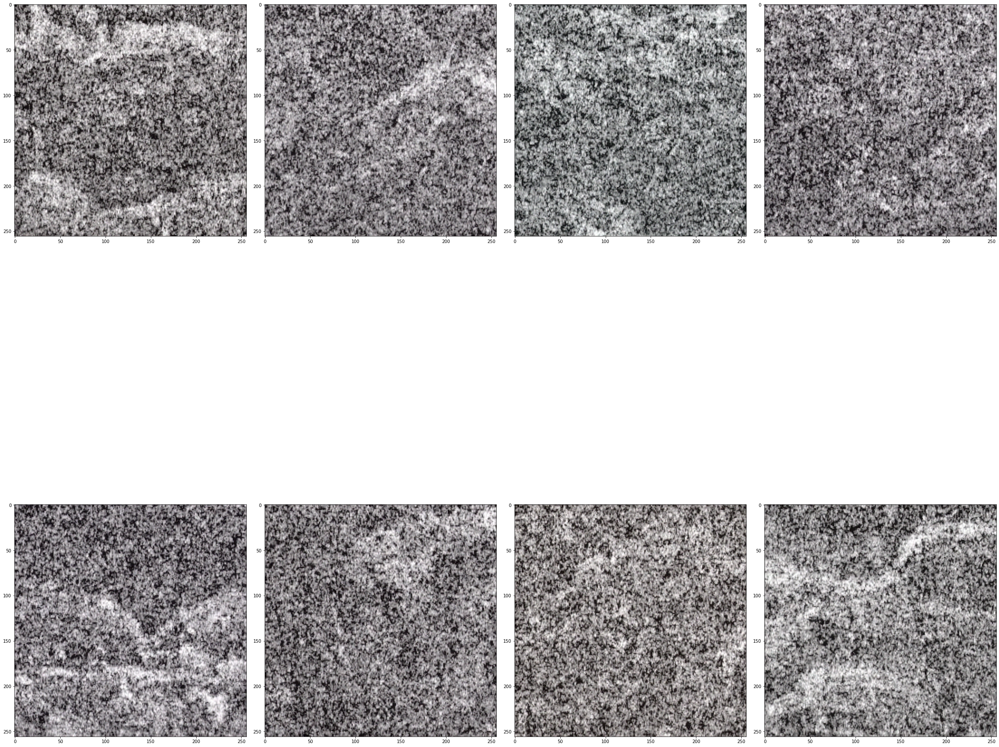

In [16]:
display_imgs(d250_p1_run, d250_p2_run, D250_P1_BUFF_PLT, STEP_NUMBER, reduce_step=False, buffer=D250_BUFFER)

In [ ]:
compare_from_buffer(D250_BUFFER, D1000_BUFFER, STEP_NUMBER)

In [17]:
d250_df = pd.concat([d1000_p1_run.history(), d250_p2_run.history()], ignore_index=True)

In [18]:
for col in METRICS_TO_LOOK_FOR:
    fig = go.Figure()

    fig.update_layout(
        title=f"{col} D1000 vs D250",
        xaxis_title="Step",
        yaxis_title=col,
    )

    fig.add_trace(go.Scatter(x=d250_df["step"],   y=d250_df[col], mode="lines", name="D250"))
    fig.add_trace(go.Scatter(x=d1000_df["step"],    y=d1000_df[col], mode="lines", name="D1000"))

    fig.show()